# Chapter 4 - Pathways 4.4

In [1]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import networkx as nx
import pandas as pd
import glob
import numpy as np
import pickle 
import statistics as st
import seaborn as sb
import random as rd

In [2]:
class SuperPathwayClass:
    def __init__(self, name,idPathway,geneSet,networkWithCCs,networkLCC,drivers):
        self.name = name
        self.idPathway = idPathway
        self.geneSet = geneSet
        self.networkCCs = networkWithCCs
        self.networkLCC = networkLCC
        self.drivers = drivers
        self.topologicalFeaturesLCC = None
        self.layout_LCC_kamada_kawai= None
        self.layout_CCs_spring = None
        
    def info(self):
        info={}
        info['Name'] = self.name
        info['idPathway'] = self.idPathway        
        info['lenSet'] = len(self.geneSet)
        info['lenCCs'] = str(len(self.networkCCs.nodes)) +' ('+str(round(len(self.networkCCs.nodes)/len(self.geneSet)*100))+'%)'
        info['lenLCC'] = str(len(self.networkLCC.nodes)) +' ('+str(round(len(self.networkLCC.nodes)/len(self.geneSet)*100))+'%)'       
        driversLen = len(self.drivers)
        info['driversLCC'] = driversLen
        info['drivers %'] = round(driversLen/len(self.networkLCC.nodes)*100)
        
        return info

In [3]:
file = open("inputs/superPathwaysObjs.pkl", "rb")
superPathwaysObjs = pickle.load(file)
overView={}
for k in sorted(superPathwaysObjs):
    overView[k]=superPathwaysObjs[k].info()
    
overViewDf=pd.DataFrame.from_dict(overView,orient='index')
overViewDf.set_index(overViewDf.columns[0],inplace=True)
overViewDf.sort_values(by=['drivers %'],ascending=False).head()

,idPathway,lenSet,lenCCs,lenLCC,driversLCC,drivers %
Name,,,,,,
Chromatin organization,R-HSA-4839726,240,218 (91%),206 (86%),45,22
Circadian Clock,R-HSA-400253,70,69 (99%),64 (91%),12,19
DNA Repair,R-HSA-73894,312,290 (93%),284 (91%),48,17
Reproduction,R-HSA-1474165,114,95 (83%),81 (71%),14,17
Disease,R-HSA-1643685,1888,1513 (80%),1415 (75%),206,15


In [4]:
targetPathways=['Chromatin Organization','Circadian Clock','DNA Repair','Reproduction']
superPathwaysObjs['Chromatin Organization']=superPathwaysObjs['Chromatin organization']
superPathwaysObjs['Chromatin Organization'].name='Chromatin Organization'

# Rename the column names

In [5]:
for name in superPathwaysObjs:
    superPathwaysObjs[name].topologicalFeaturesLCC.rename(
        columns={
            'degree':'Degree',
            'kcore':'Kcore',
            'eigenvector':'Eigenvector',
            'averageNeighbor': 'AvgNeighbors', 
            'clusteringcoeff': 'Clustering',
            'leverage': 'Leverage',
            'eccentricity': 'Eccentricity',
            'betweenness': 'Betweenness',
            'closeness': 'Closeness',
            'bridging': 'Bridging',
        },inplace=True)
    superPathwaysObjs[name].topologicalFeaturesLCC

# Plotting Networks

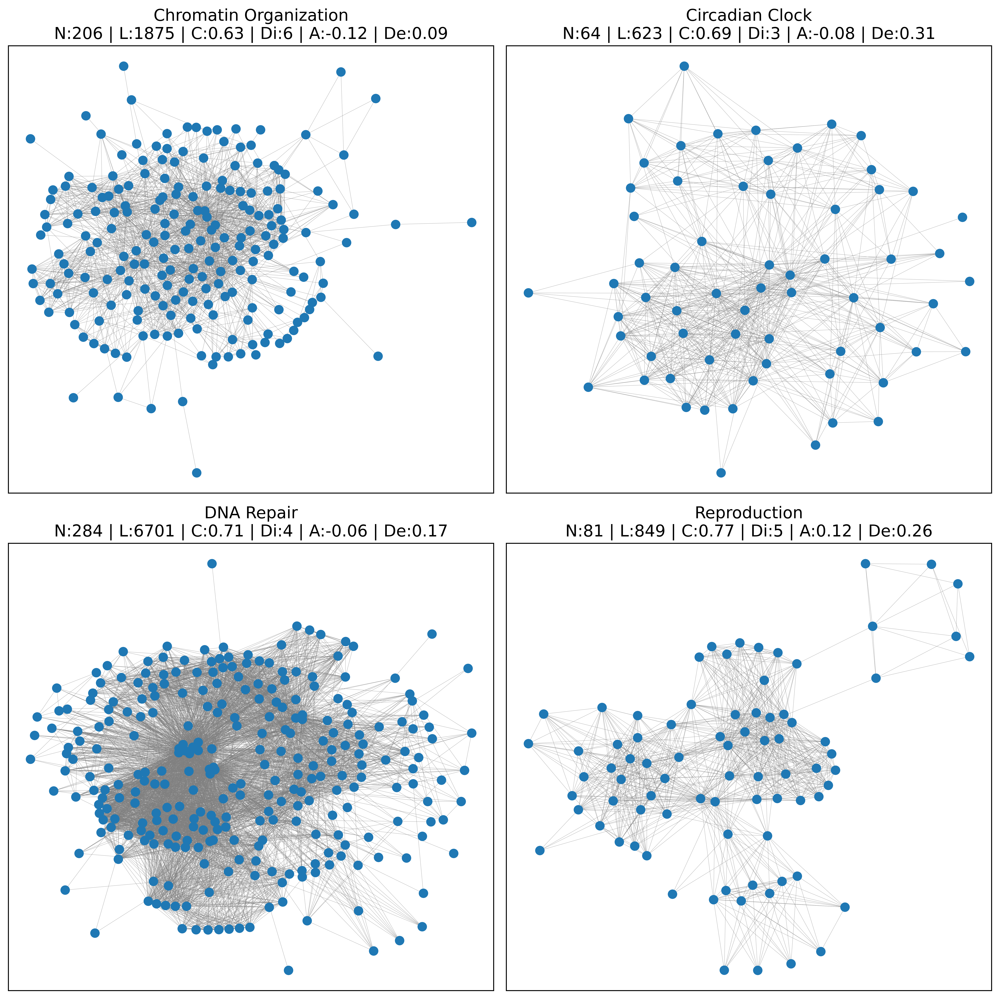

In [6]:
plt.figure(figsize=(12,12),dpi=550)
for i,pName in enumerate(targetPathways):
    
    obj = superPathwaysObjs[pName]
    G=obj.networkLCC
    pos=obj.layout_LCC_kamada_kawai
    allNodes = list(G.nodes()) 
    A='A:'+str(round(nx.assortativity.degree_assortativity_coefficient(G),2))
    Di='Di:'+str(round(nx.diameter(G),2))
    De='De:'+str(round(nx.density(G),2))
    C='C:'+str(round(nx.average_clustering(G),2))
    N='N:'+str(G.number_of_nodes())
    L='L:'+str(G.number_of_edges())
    name=obj.name+'\n'+N+' | '+L+' | '+C+' | '+Di+' | '+A+' | '+De
   
    plt.subplot(2,2,i+1)
    nx.draw_networkx_nodes(G, pos=pos, node_size=50, nodelist=allNodes, node_color='#1f78b4',node_shape='o')
    nx.draw_networkx_edges(G, pos=pos, alpha=1, edge_color='gray',width=0.15)
    plt.title(name,fontsize=14)
    plt.tight_layout()


plt.savefig("ouput/4.4 Networks.png", format='png', dpi=550)
plt.savefig("ouput/4.4 Networks.svg", format='svg')
plt.savefig("ouput/4.4 Networks.pdf", format='pdf')
plt.show()
plt.close()

### Plotting Centrality

#### Correlation

In [7]:
correlationOrder=['Degree', 'Eigenvector', 'Leverage', 'Closeness', 'Betweenness', 'Kcore', 'Bridging', 'AvgNeighbors', 'Clustering', 'Eccentricity']

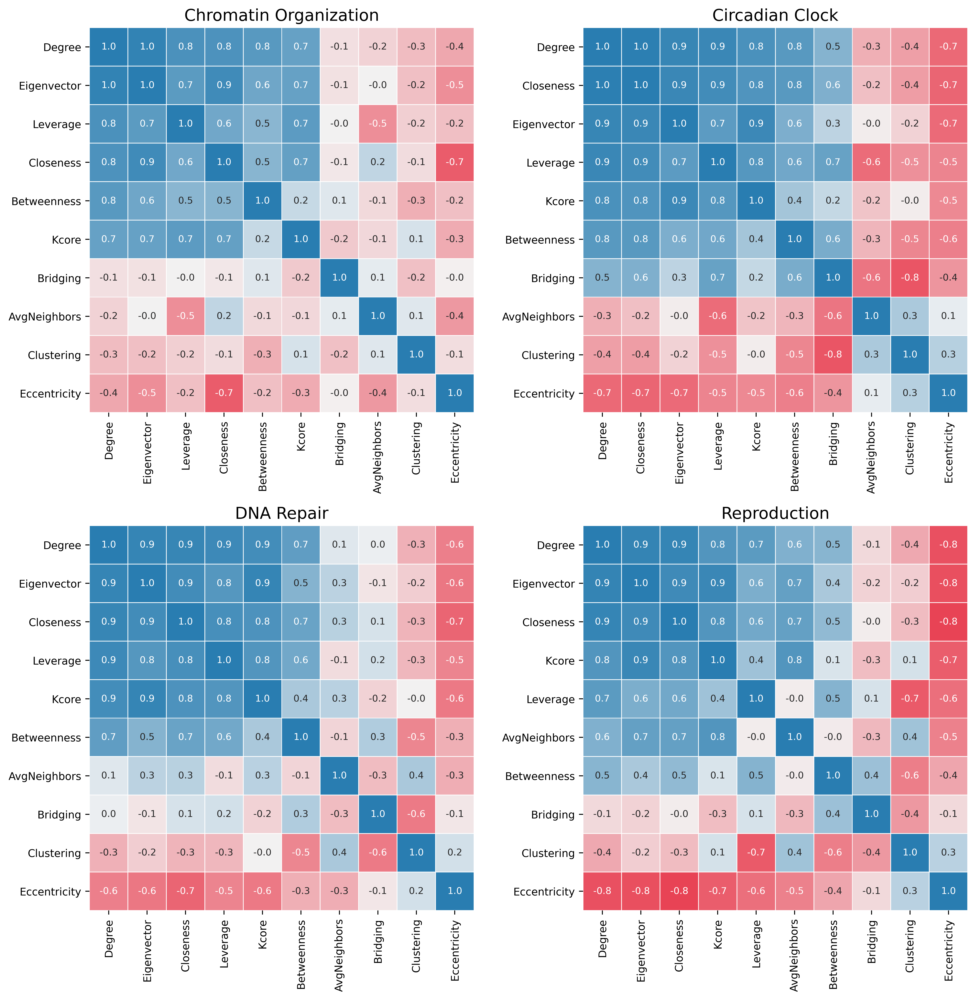

Wall time: 22.4 s


In [8]:
%%time
plt.figure(figsize=(12,12),dpi=550) 
degreeCorrOrderList=[]
for i,name in enumerate(targetPathways):
    ax=plt.subplot(2,2,i+1)
    plt.title(name,fontsize=14)
    df = superPathwaysObjs[name].topologicalFeaturesLCC.copy()
    #normalize 0~1
    df=(df-df.min())/(df.max()-df.min())
    df_corr = df.corr()
    #Reorder based on degree correlation
    degreeCorrOrder=list(dict(sorted(dict(df_corr['Degree']).items(),key=lambda x:x[1],reverse=True)).keys())
    df = df[degreeCorrOrder]
    degreeCorrOrderList.append(degreeCorrOrder)
    #Recalculte the correlation Matriz. Seens better/easier than shape the original df_corr
    df_corr = df.corr()
    # color map
    cmap = sb.diverging_palette(10,240,90, as_cmap=True)
    ax=sb.heatmap(df_corr,annot=True, fmt=".1f", 
               linewidths=0.5, cmap=cmap, vmin=-1, vmax=1, 
               cbar=False, square=True,annot_kws={"size": 8})
   
    plt.yticks(rotation=0,fontsize=9)
    plt.xticks(rotation=90,fontsize=9)
    plt.tight_layout()  


plt.tight_layout()
plt.savefig("ouput/4.4 Correlation.png", format='png', dpi=550)
plt.savefig("ouput/4.4 Correlation.svg", format='svg')
plt.savefig("ouput/4.4 Correlation.pdf", format='pdf')
plt.show()
plt.close()

### Box Plot

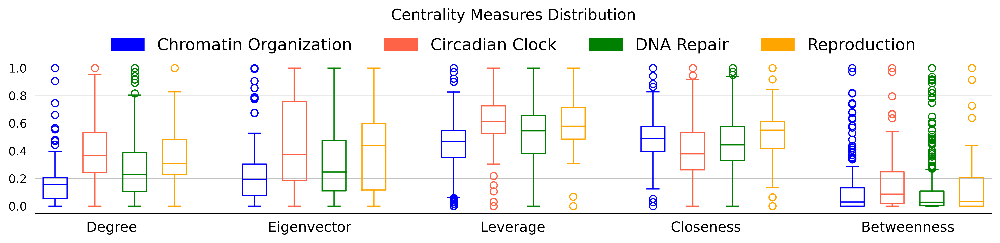

In [12]:
#Plot Setting
fig, ax = plt.subplots(figsize=(12, 3),dpi=550)
# Remove top and right border
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
# Remove y-axis tick marks
ax.yaxis.set_ticks_position('none') 
ax.xaxis.set_ticks_position('none') 
ax.set_title('Centrality Measures Distribution\n\n',fontsize=13)
# Add major gridlines in the y-axis
ax.grid(color='grey', axis='y', linestyle='-', linewidth=0.25, alpha=0.5)
whiteColor = dict(color='white')
contColumns=0

for col in correlationOrder[:5]:
    for name in targetPathways:
        df=superPathwaysObjs[name].topologicalFeaturesLCC.copy()
        #normalize 0~1
        df=(df-df.min())/(df.max()-df.min())
        
        #Remove the outliers from Betweeness #ignore the top 0,05%
        if(col=='Betweenness'):            
            th=int(len(df['Betweenness'])*0.05)
            dfBet=pd.DataFrame()
            dfBet['Betweenness']=df['Betweenness'].sort_values()[0:-th]
            dfBet=(dfBet-dfBet.min())/(dfBet.max()-dfBet.min())
            measures = dfBet['Betweenness']
        else:
            measures = df[col]

        ####START PLOTTING    
        labels=[name]
        
        if(name=='Chromatin Organization'):
            Color = dict(color='blue')
        elif(name=='Circadian Clock'):
            Color = dict(color='tomato')
        elif(name=='DNA Repair'):
            Color = dict(color='green')
        elif(name=='Reproduction'):
            Color = dict(color='orange')
        
        contColumns+=1
        ax.boxplot(measures, positions=[contColumns],widths = 0.6, boxprops=Color, medianprops=Color, whiskerprops=Color, capprops=Color, flierprops=dict(markeredgecolor=list(Color.values())[0]))

    #Fake plot, just to add a space between three that matters
    contColumns+=1
    if(contColumns!=25):
        ax.boxplot([0.1],positions=[contColumns], widths = 0, boxprops=whiteColor, medianprops=whiteColor, whiskerprops=whiteColor, capprops=whiteColor,flierprops=dict(markeredgecolor=list(whiteColor.values())[0]))

ax.set_xticks(np.arange(1,25,5))
ax.set_xticklabels(['       Degree', '   Eigenvector', '      Leverage', '    Closeness', '  Betweenness'],fontsize=12,fontdict={'horizontalalignment': 'left'})
plt.yticks(fontsize=10)

patch1 = mpatches.Patch(color='blue', label='Chromatin Organization')
patch2 = mpatches.Patch(color='tomato', label='Circadian Clock')
patch3 = mpatches.Patch(color='green', label='DNA Repair')
patch4 = mpatches.Patch(color='orange', label='Reproduction')
plt.tight_layout()
plt.legend(fontsize=14,handles=[patch1,patch2,patch3,patch4],frameon=False, loc='upper center', ncol=4,bbox_to_anchor=(.5, 1.25))
plt.savefig("ouput/4.4 Centrality1.png", format='png', dpi=550)
plt.savefig("ouput/4.4 Centrality1.svg", format='svg')
plt.savefig("ouput/4.4 Centrality1.pdf", format='pdf')
plt.show()
plt.close()

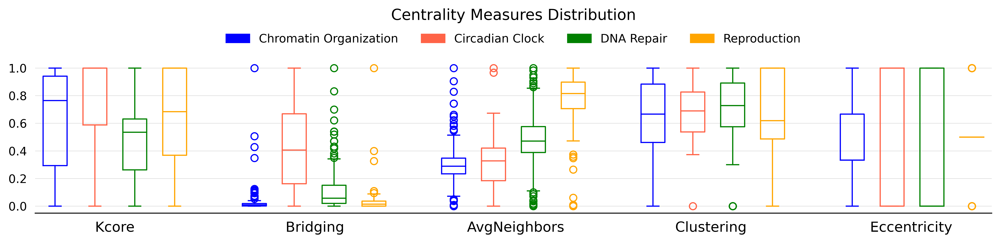

In [10]:
#Plot Setting
fig, ax = plt.subplots(figsize=(12, 3),dpi=550)
# Remove top and right border
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
# Remove y-axis tick marks
ax.yaxis.set_ticks_position('none') 
ax.xaxis.set_ticks_position('none') 
ax.set_title('Centrality Measures Distribution\n\n',fontsize=13)
# Add major gridlines in the y-axis
ax.grid(color='grey', axis='y', linestyle='-', linewidth=0.25, alpha=0.5)
whiteColor = dict(color='white')
contColumns=0

for col in correlationOrder[5:]:
    for name in targetPathways:
        df=superPathwaysObjs[name].topologicalFeaturesLCC.copy()
        #normalize 0~1
        df=(df-df.min())/(df.max()-df.min())
        
        #Remove the outliers from Betweeness #ignore the top 0,05%
        if(col=='Betweenness'):            
            th=int(len(df['Betweenness'])*0.05)
            dfBet=pd.DataFrame()
            dfBet['Betweenness']=df['Betweenness'].sort_values()[0:-th]
            dfBet=(dfBet-dfBet.min())/(dfBet.max()-dfBet.min())
            measures = dfBet['Betweenness']
        else:
            measures = df[col]

        ####START PLOTTING    
        labels=[name]
        
        if(name=='Chromatin Organization'):
            Color = dict(color='blue')
        elif(name=='Circadian Clock'):
            Color = dict(color='tomato')
        elif(name=='DNA Repair'):
            Color = dict(color='green')
        elif(name=='Reproduction'):
            Color = dict(color='orange')
        
        contColumns+=1
        ax.boxplot(measures, positions=[contColumns],widths = 0.6, boxprops=Color, medianprops=Color, whiskerprops=Color, capprops=Color, flierprops=dict(markeredgecolor=list(Color.values())[0]))

    #Fake plot, just to add a space between three that matters
    contColumns+=1
    if(contColumns!=25):
        ax.boxplot([0.1],positions=[contColumns], widths = 0, boxprops=whiteColor, medianprops=whiteColor, whiskerprops=whiteColor, capprops=whiteColor,flierprops=dict(markeredgecolor=list(whiteColor.values())[0]))

ax.set_xticks(np.arange(1,25,5))
ax.set_xticklabels(['         Kcore', '       Bridging', '   AvgNeighbors', '     Clustering', '    Eccentricity'],fontsize=12,fontdict={'horizontalalignment': 'left'})
plt.yticks(fontsize=10)

patch1 = mpatches.Patch(color='blue', label='Chromatin Organization')
patch2 = mpatches.Patch(color='tomato', label='Circadian Clock')
patch3 = mpatches.Patch(color='green', label='DNA Repair')
patch4 = mpatches.Patch(color='orange', label='Reproduction')
plt.tight_layout()
plt.legend(handles=[patch1,patch2,patch3,patch4],frameon=False, loc='upper center', ncol=4,bbox_to_anchor=(.5, 1.25))
plt.savefig("ouput/4.4 Centrality2.png", format='png', dpi=550)
plt.savefig("ouput/4.4 Centrality2.svg", format='svg')
plt.savefig("ouput/4.4 Centrality2.pdf", format='pdf')
plt.show()
plt.close()

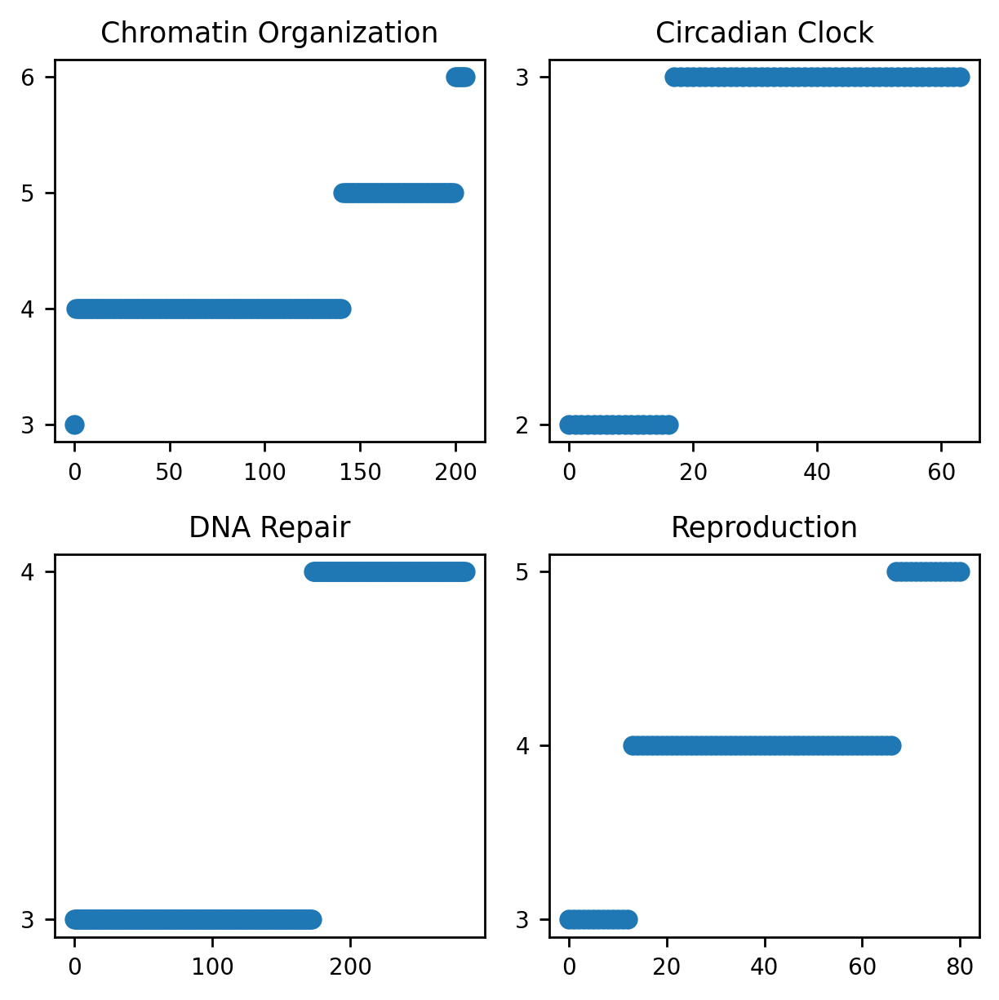

In [11]:
plt.subplots(figsize=(5, 5),dpi=250)
for i,name in enumerate(targetPathways):
    plt.subplot(2,2,i+1)
    plt.title(name,fontsize=10)
    measure=sorted(superPathwaysObjs[name].topologicalFeaturesLCC['Eccentricity'])
    plt.plot(measure,'o')
    plt.yticks(list(set(measure)),fontsize=8)
    plt.xticks(fontsize=8)
plt.tight_layout()
plt.savefig("ouput/4.4 Eccentricity.png", format='png', dpi=550)
plt.savefig("ouput/4.4 Eccentricity.svg", format='svg')
plt.savefig("ouput/4.4 Eccentricity.pdf", format='pdf')
plt.show()